<h1 style="text-align:center;color:#06344ef6;font-size:50px;font-family:Bell MT ;border:solid"> Initiation au machine learning : Projet final 2023 - 2024 </h1>

<div style="display:flex;text-align:justify">
    
<ul style="text-align:justify;font-family:bodoni MT;font-size:25px;list-style-type:circle; width:60%"> 
<span style="font-weight:bold">Réalisé par: </span> 
    <ul style="text-align:justify;font-family:times;font-size:18px;list-style-type:circle"> 
        <li>Fallou BADJI</li>   
        <li> Pathé DIAGNE</li>                                      
        <li>Diakhou NDAO</li>
        <li>Marie Agathe SECK</li>
    </ul>
    <span style="font-style:italic;color:#06344ef6;font-size:14px">Eléves Ingénieurs statisticiens économistes</span>
</ul>
 
<ul style="text-align:justify;font-family:bodoni MT;font-size:23px;list-style-type:none;width:39%"> 
 <li style="font-weight:bold">Sous la supervision de:</li> 
<li>Mme Mously DIAW</li>                                     
  <span style="font-style:italic;color:#06344ef6;font-size:15px"> Machine Learning Engineer - Formatrice IA </span>
</ul>
    
</div>

<h1 style="text-align:center;color:#06344ef6;font-size:30px;font-family:bodoni MT"> Objectif : Prédiction de la consommation d'énergie des batiments non destinés à l'habitation de la ville de Seattle</h1>

Pour atteindre son objectif de ville neutre en émissions de carbone en 2050, nous nous intéressons de près à la consommation totale d’énergie des bâtiments non destinés à l’habitation de la ville de Seattle.
nos prédictions se baseront sur les données déclaratives du permis d'exploitation commerciale (taille et usage des bâtiments, mention de travaux récents, date de construction..).

**<h1 style="color:#06344ef6;text-align:center;font-size:35px;font-family:Bodoni MT"> I- Analyse exploratoire des données </h1>**


## Chargement des modules

In [281]:
from pathlib import Path
import matplotlib.pyplot as plt
import missingno as msno
import numpy as np
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
import scipy as sp
import seaborn as sns
from ydata_profiling import ProfileReport
from yellowbrick.regressor import ResidualsPlot
from scipy.stats.mstats import winsorize
import folium
import folium.plugins
# afficher toutes les variables
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

# Supprimer les avertissements 
import warnings
warnings.filterwarnings("ignore")


## Importation de la base

In [282]:
# repertoire courant
%pwd

'C:\\Users\\LENOVO\\projet_ML\\notebooks'

In [283]:
donnes = pd.read_csv('../data/2016_Building_Energy_Benchmarking.csv')

In [284]:
donnes.head()

,OSEBuildingID,DataYear,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,ZipCode,TaxParcelIdentificationNumber,CouncilDistrictCode,Neighborhood,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),ListOfAllPropertyUseTypes,LargestPropertyUseType,LargestPropertyUseTypeGFA,SecondLargestPropertyUseType,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseType,ThirdLargestPropertyUseTypeGFA,YearsENERGYSTARCertified,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),DefaultData,Comments,ComplianceStatus,Outlier,TotalGHGEmissions,GHGEmissionsIntensity
0,1,2016,NonResidential,Hotel,Mayflower park hotel,405 Olive way,Seattle,WA,98101.0,0659000030,7,DOWNTOWN,47.61220,-122.33799,1927,1.0,12,88434,0,88434,Hotel,Hotel,88434.0,NaN,NaN,NaN,NaN,NaN,60.0,81.699997,84.300003,182.500000,189.000000,7226362.5,7456910.0,2003882.00,1.156514e+06,3946027.0,12764.52930,1276453.0,False,NaN,Compliant,NaN,249.98,2.83
1,2,2016,NonResidential,Hotel,Paramount Hotel,724 Pine street,Seattle,WA,98101.0,0659000220,7,DOWNTOWN,47.61317,-122.33393,1996,1.0,11,103566,15064,88502,"Hotel, Parking, Restaurant",Hotel,83880.0,Parking,15064.0,Restaurant,4622.0,NaN,61.0,94.800003,97.900002,176.100006,179.399994,8387933.0,8664479.0,0.00,9.504252e+05,3242851.0,51450.81641,5145082.0,False,NaN,Compliant,NaN,295.86,2.86
2,3,2016,NonResidential,Hotel,5673-The Westin Seattle,1900 5th Avenue,Seattle,WA,98101.0,0659000475,7,DOWNTOWN,47.61393,-122.33810,1969,1.0,41,956110,196718,759392,Hotel,Hotel,756493.0,NaN,NaN,NaN,NaN,NaN,43.0,96.000000,97.699997,241.899994,244.100006,72587024.0,73937112.0,21566554.00,1.451544e+07,49526664.0,14938.00000,1493800.0,False,NaN,Compliant,NaN,2089.28,2.19
3,5,2016,NonResidential,Hotel,HOTEL MAX,620 STEWART ST,Seattle,WA,98101.0,0659000640,7,DOWNTOWN,47.61412,-122.33664,1926,1.0,10,61320,0,61320,Hotel,Hotel,61320.0,NaN,NaN,NaN,NaN,NaN,56.0,110.800003,113.300003,216.199997,224.000000,6794584.0,6946800.5,2214446.25,8.115253e+05,2768924.0,18112.13086,1811213.0,False,NaN,Compliant,NaN,286.43,4.67
4,8,2016,NonResidential,Hotel,WARWICK SEATTLE HOTEL (ID8),401 LENORA ST,Seattle,WA,98121.0,0659000970,7,DOWNTOWN,47.61375,-122.34047,1980,1.0,18,175580,62000,113580,"Hotel, Parking, Swimming Pool",Hotel,123445.0,Parking,68009.0,Swimming Pool,0.0,NaN,75.0,114.800003,118.699997,211.399994,215.600006,14172606.0,14656503.0,0.00,1.573449e+06,5368607.0,88039.98438,8803998.0,False,NaN,Compliant,NaN,505.01,2.88


## Description globale

In [285]:
# dimension
donnes.shape

(3376, 46)

Nous avons un jeu de données composé de 3376 individus (les batiments) et 46 variables relatifs à leur caractéristiques, leur consommation d'énergie etc...

In [286]:
# dictionnaire des variables
donnes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3376 entries, 0 to 3375
Data columns (total 46 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   OSEBuildingID                    3376 non-null   int64  
 1   DataYear                         3376 non-null   int64  
 2   BuildingType                     3376 non-null   object 
 3   PrimaryPropertyType              3376 non-null   object 
 4   PropertyName                     3376 non-null   object 
 5   Address                          3376 non-null   object 
 6   City                             3376 non-null   object 
 7   State                            3376 non-null   object 
 8   ZipCode                          3360 non-null   float64
 9   TaxParcelIdentificationNumber    3376 non-null   object 
 10  CouncilDistrictCode              3376 non-null   int64  
 11  Neighborhood                     3376 non-null   object 
 12  Latitude            

In [287]:
# supprimer la variable comments (entierement vide)
donnes = donnes.drop(columns=['Comments'])
donnes.shape

(3376, 45)

In [288]:
# calculer nombre de PropertyUSEType dans le batiment
Total = [str(word).count(",") + 1 for word in donnes['ListOfAllPropertyUseTypes'].str.split(',')]

donnes = donnes.assign(UseTypeNumber =Total)
donnes['UseTypeNumber'].head()

0    1
1    3
2    1
3    1
4    3
Name: UseTypeNumber, dtype: int64

In [289]:
# summary des variables quantitatives
donnes.describe()

,OSEBuildingID,DataYear,ZipCode,CouncilDistrictCode,Latitude,Longitude,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,SecondLargestPropertyUseTypeGFA,ThirdLargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEUIWN(kBtu/sf),SourceEUI(kBtu/sf),SourceEUIWN(kBtu/sf),SiteEnergyUse(kBtu),SiteEnergyUseWN(kBtu),SteamUse(kBtu),Electricity(kWh),Electricity(kBtu),NaturalGas(therms),NaturalGas(kBtu),TotalGHGEmissions,GHGEmissionsIntensity,UseTypeNumber
count,3376.000000,3376.0,3360.000000,3376.000000,3376.000000,3376.000000,3376.000000,3368.000000,3376.000000,3.376000e+03,3376.000000,3.376000e+03,3.356000e+03,1679.000000,596.000000,2533.000000,3369.000000,3370.000000,3367.000000,3367.000000,3.371000e+03,3.370000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3.367000e+03,3367.000000,3367.000000,3376.000000
mean,21208.991114,2016.0,98116.949107,4.439277,47.624033,-122.334795,1968.573164,1.106888,4.709123,9.483354e+04,8001.526066,8.683201e+04,7.917764e+04,28444.075817,11738.675166,67.918674,54.732116,57.033798,134.232848,137.783932,5.403667e+06,5.276726e+06,2.745959e+05,1.086639e+06,3.707612e+06,1.368505e+04,1.368505e+06,119.723971,1.175916,1.794727
std,12223.757015,0.0,18.615205,2.120625,0.047758,0.027203,33.088156,2.108402,5.494465,2.188376e+05,32326.723928,2.079398e+05,2.017034e+05,54392.917928,29331.199286,26.873271,56.273124,57.163330,139.287554,139.109807,2.161063e+07,1.593879e+07,3.912173e+06,4.352478e+06,1.485066e+07,6.709781e+04,6.709781e+06,538.832227,1.821452,1.101211
min,1.000000,2016.0,98006.000000,1.000000,47.499170,-122.414250,1900.000000,0.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,-2.100000,0.000000e+00,0.000000e+00,0.000000e+00,-3.382680e+04,-1.154170e+05,0.000000e+00,0.000000e+00,-0.800000,-0.020000,1.000000
25%,19990.750000,2016.0,98105.000000,3.000000,47.599860,-122.350662,1948.000000,1.000000,2.000000,2.848700e+04,0.000000,2.775600e+04,2.509475e+04,5000.000000,2239.000000,53.000000,27.900000,29.400000,74.699997,78.400002,9.251286e+05,9.701822e+05,0.000000e+00,1.874229e+05,6.394870e+05,0.000000e+00,0.000000e+00,9.495000,0.210000,1.000000
50%,23112.000000,2016.0,98115.000000,4.000000,47.618675,-122.332495,1975.000000,1.000000,4.000000,4.417500e+04,0.000000,4.321600e+04,3.989400e+04,10664.000000,5043.000000,75.000000,38.599998,40.900002,96.199997,101.099998,1.803753e+06,1.904452e+06,0.000000e+00,3.451299e+05,1.177583e+06,3.237538e+03,3.237540e+05,33.920000,0.610000,1.000000
75%,25994.250000,2016.0,98122.000000,7.000000,47.657115,-122.319407,1997.000000,1.000000,5.000000,9.099200e+04,0.000000,8.427625e+04,7.620025e+04,26640.000000,10138.750000,90.000000,60.400002,64.275002,143.899994,148.349998,4.222455e+06,4.381429e+06,0.000000e+00,8.293178e+05,2.829632e+06,1.189033e+04,1.189034e+06,93.940000,1.370000,2.000000
max,50226.000000,2016.0,98272.000000,7.000000,47.733870,-122.220966,2015.000000,111.000000,99.000000,9.320156e+06,512608.000000,9.320156e+06,9.320156e+06,686750.000000,459748.000000,100.000000,834.400024,834.400024,2620.000000,2620.000000,8.739237e+08,4.716139e+08,1.349435e+08,1.925775e+08,6.570744e+08,2.979090e+06,2.979090e+08,16870.980000,34.090000,13.000000


In [290]:
# summary des variables qualitatives (nbre de modalités, mode et son effectif)
donnes.describe(include=[object])

,BuildingType,PrimaryPropertyType,PropertyName,Address,City,State,TaxParcelIdentificationNumber,Neighborhood,ListOfAllPropertyUseTypes,LargestPropertyUseType,SecondLargestPropertyUseType,ThirdLargestPropertyUseType,YearsENERGYSTARCertified,ComplianceStatus,Outlier
count,3376,3376,3376,3376,3376,3376,3376,3376,3367,3356,1679,596,119,3376,32
unique,8,24,3362,3354,1,1,3268,19,466,56,50,44,65,4,2
top,NonResidential,Low-Rise Multifamily,Northgate Plaza,2600 SW Barton St,Seattle,WA,1625049001,DOWNTOWN,Multifamily Housing,Multifamily Housing,Parking,Retail Store,2016,Compliant,Low outlier
freq,1460,987,3,4,3376,3376,8,573,866,1667,976,110,14,3211,23


## Extraction des données des bâtiments non destinés à l’habitation 

In [291]:
data = donnes.copy()

In [292]:
# regarder la distribution des types de batiments
data['BuildingType'].value_counts()

NonResidential          1460
Multifamily LR (1-4)    1018
Multifamily MR (5-9)     580
Multifamily HR (10+)     110
SPS-District K-12         98
Nonresidential COS        85
Campus                    24
Nonresidential WA          1
Name: BuildingType, dtype: int64

In [293]:
### Sélectionner uniquement les données des batiments non habitables
data = data.loc[(data['BuildingType']=='NonResidential')| (data['BuildingType']=='Nonresidential WA')| (data['BuildingType']=='Nonresidential COS'),:]
#verifier
data['BuildingType'].value_counts()

NonResidential        1460
Nonresidential COS      85
Nonresidential WA        1
Name: BuildingType, dtype: int64

In [294]:
# verifier l'utilisation principale des batiments nonresidential
data['PrimaryPropertyType'].unique()

array(['Hotel', 'Other', 'Mixed Use Property', 'University',
       'Small- and Mid-Sized Office', 'Self-Storage Facility',
       'Warehouse', 'K-12 School', 'Large Office',
       'Senior Care Community', 'Medical Office', 'Retail Store',
       'Hospital', 'Residence Hall', 'Distribution Center',
       'Worship Facility', 'Supermarket / Grocery Store', 'Laboratory',
       'Refrigerated Warehouse', 'Restaurant', 'Low-Rise Multifamily',
       'Office'], dtype=object)

On peut voir ici qu'au niveau de l'utilisation principale des batiments nous avons Low-Rise Multifamily qui peut être assimilé à un type de batiment destiné à l'habitation. Nous allons dans la suite l'enlever de notre dataset.

In [295]:
# enlever la modalité "Low-Rise Multifamily"
data = data[data['PrimaryPropertyType'] != "Low-Rise Multifamily"]
data.shape

(1544, 46)

## Analyses descriptives

__visualisation des batiments dans sur la carte de la ville__

In [296]:
# visualiser l'emplacement des batiments dans la ville de seattle
seattle_map = folium.Map(location=data[['Latitude','Longitude']].mean().tolist(), zoom_start=11)

#Clusters
marker_cluster = folium.plugins.MarkerCluster().add_to(seattle_map)
for lat, lng, in zip(data.Latitude, data.Longitude):
    folium.Marker(location=[lat, lng]).add_to(marker_cluster)

seattle_map

__Distribution selon le quartier et le type de résidence__

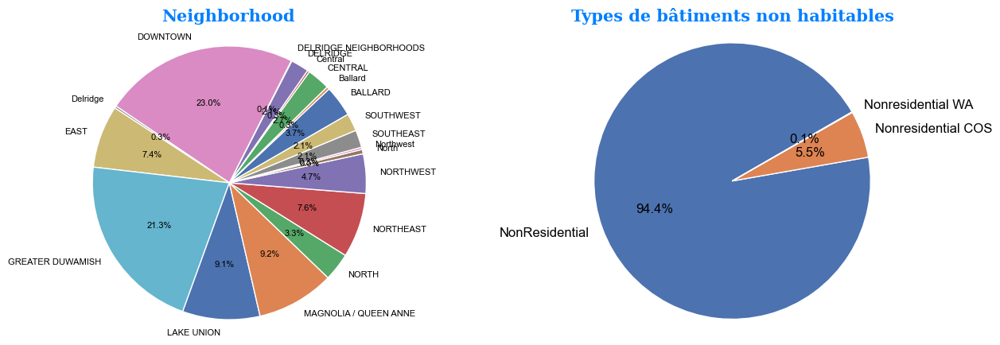

In [297]:
BuildingType = data.groupby('BuildingType')['OSEBuildingID'].nunique()
Neighborhood = data.groupby('Neighborhood')['OSEBuildingID'].nunique()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

ax2.pie(BuildingType.values, labels=BuildingType.index, autopct='%1.1f%%', startangle=30, textprops=dict(color="black", size=12))
ax2.axis('equal')
ax2.set_title("Types de bâtiments non habitables", fontdict={'family': 'serif', 'color': '#007FFF', 'weight': 'bold', 'size': 15})

ax1.pie(Neighborhood.values, labels=Neighborhood.index, autopct='%1.1f%%', startangle=30, textprops=dict(color="black", size=8))
ax1.axis('equal')
ax1.set_title("Neighborhood", fontdict={'family': 'serif', 'color': '#007FFF', 'weight': 'bold', 'size': 15})

plt.show()

__Nombre de bâtiments par quartier__

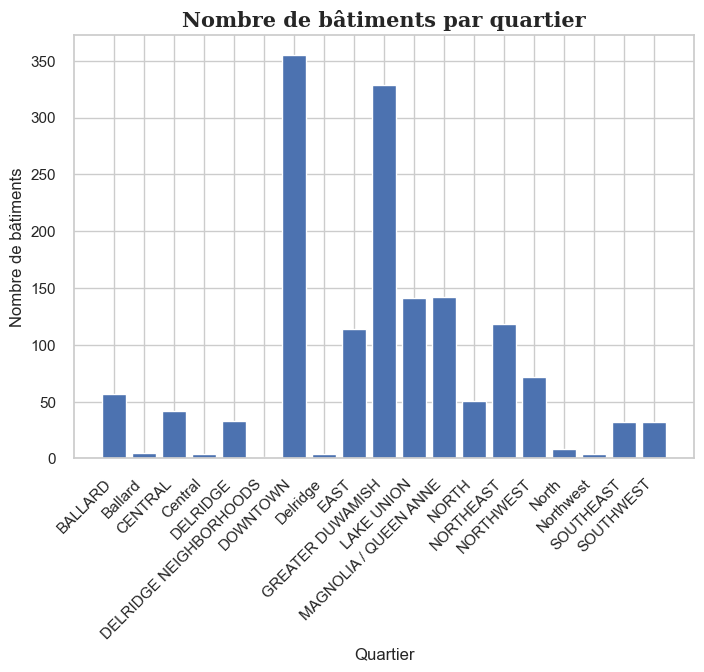

In [298]:
Neighborhood = data.groupby('Neighborhood')['OSEBuildingID'].nunique()

plt.bar(Neighborhood.index, Neighborhood.values)  # Changez la couleur à votre préférence, par exemple, 'green'
plt.xlabel('Quartier')
plt.ylabel('Nombre de bâtiments')
plt.title("Nombre de bâtiments par quartier", fontdict={'family': 'serif','weight': 'bold', 'size': 15})

plt.xticks(rotation=45, ha='right')

plt.show()

__Distribution selon l'année de construction__

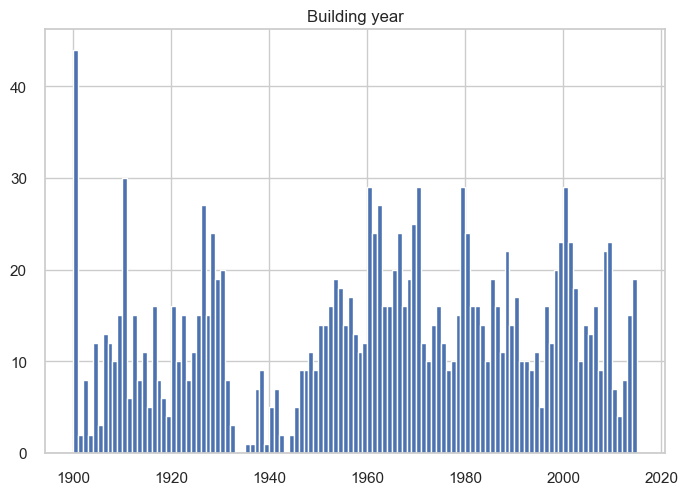

In [299]:
### Year of Building
plt.figure()
plt.hist(data['YearBuilt'], bins=115)
plt.title('Building year')
plt.show()

__Distribution de la consommation d'énergie__

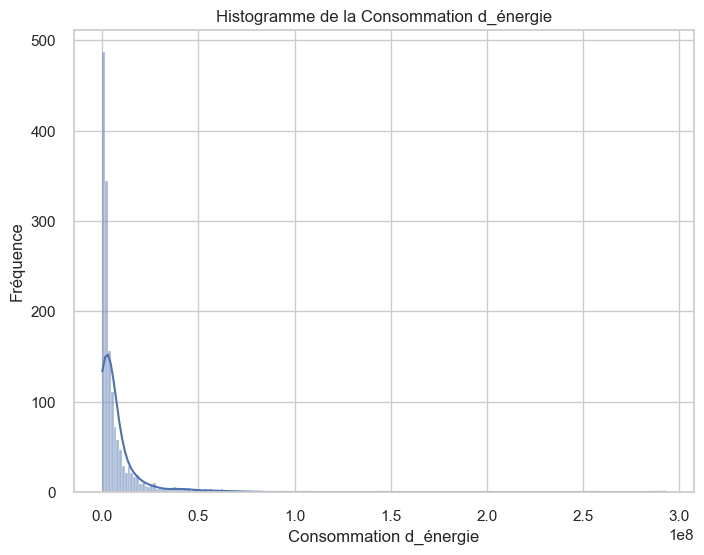

In [300]:
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.histplot(data['SiteEnergyUse(kBtu)'], bins=200, kde=True, palette='viridis') 
plt.title('Histogramme de la Consommation d_énergie')
plt.xlabel('Consommation d_énergie')
plt.ylabel('Fréquence')
plt.show()

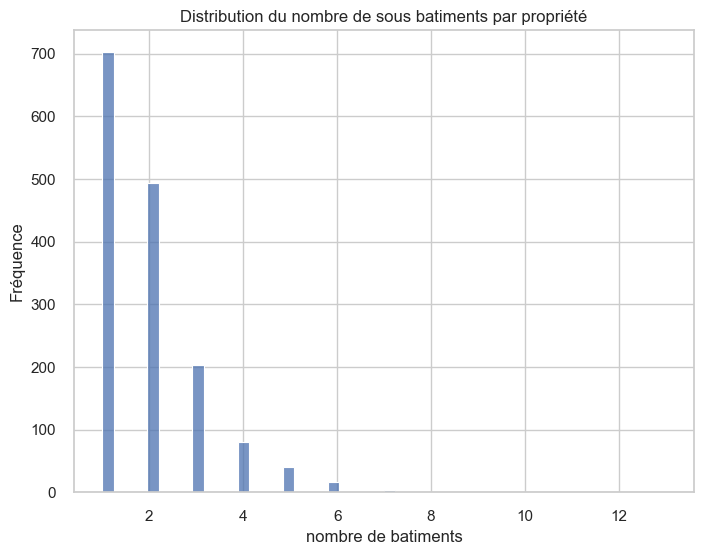

In [301]:
sns.set(style="whitegrid")
plt.figure(figsize=(8, 6))
sns.histplot(data['UseTypeNumber'], bins=50, kde=False, palette='viridis') 
plt.title('Distribution du nombre de sous batiments par propriété')
plt.xlabel('nombre de batiments')
plt.ylabel('Fréquence')
plt.show()

__Distribution de la consommation d'électricité de vapeur et de gaz et emission de gaz a effet de serre__

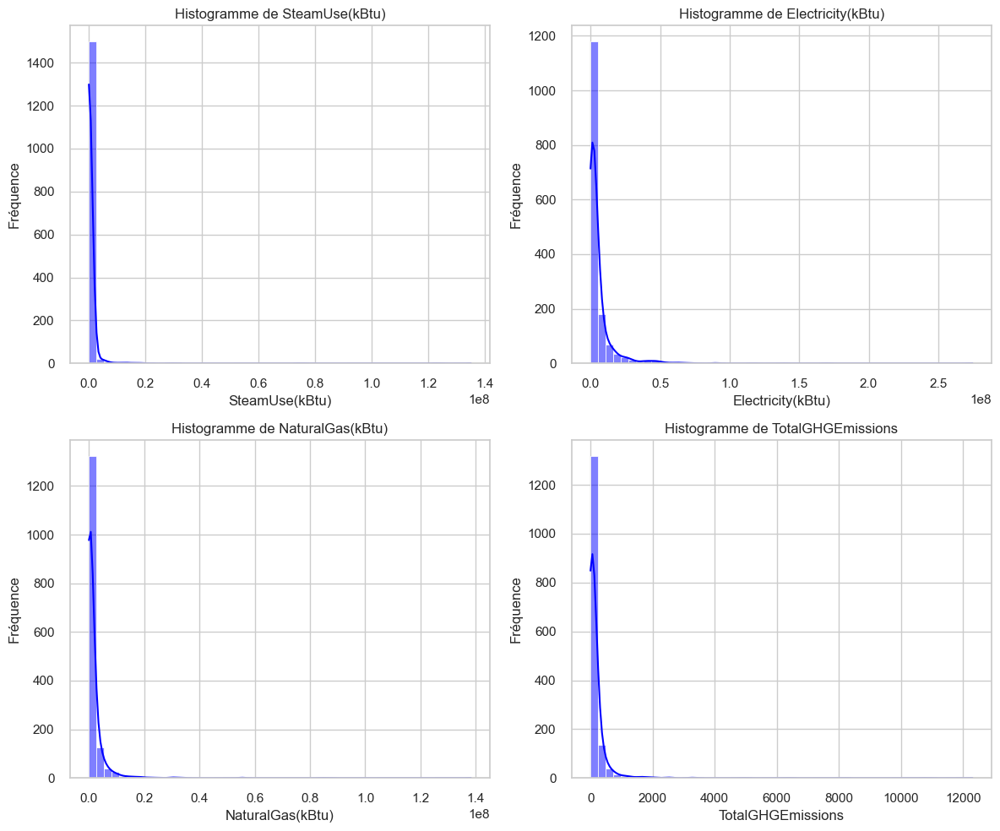

In [302]:
variables = ['SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(kBtu)', 'TotalGHGEmissions']

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 10))

for i, variable in enumerate(variables):
    row, col = i // 2, i % 2
    sns.histplot(data[variable], bins=50, kde=True, color='blue', ax=axes[row, col])
    axes[row, col].set_title(f'Histogramme de {variable}')
    axes[row, col].set_xlabel(variable)
    axes[row, col].set_ylabel('Fréquence')

plt.tight_layout()
plt.show()

__Consommation d'énergie annuelle selon la date de construction__

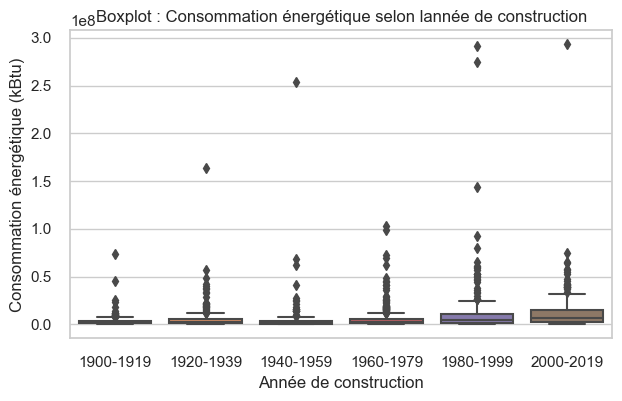

In [303]:
data['YearGroup'] = pd.cut(data['YearBuilt'], bins=[1900, 1920, 1940, 1960, 1980, 2000, 2020], 
                            labels=['1900-1919', '1920-1939', '1940-1959', '1960-1979', '1980-1999', '2000-2019'], 
                            right=False)
plt.figure(figsize=(7, 4))
sns.boxplot(x='YearGroup', y='SiteEnergyUse(kBtu)', data=data)
plt.xlabel('Année de construction')
plt.ylabel('Consommation énergétique (kBtu)')
plt.title('Boxplot : Consommation énergétique selon lannée de construction')

# Afficher le graphique
plt.show()


__Boxplot de la consommation annuelle énergetique selon l'utilisation principale__

<AxesSubplot:xlabel='SiteEnergyUse(kBtu)', ylabel='PrimaryPropertyType'>

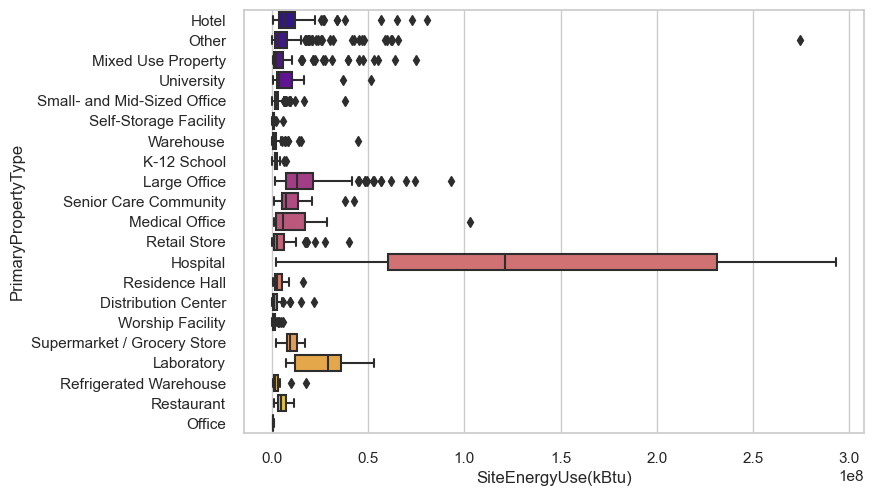

In [304]:
sns.set(style="whitegrid")
sns.boxplot(x='SiteEnergyUse(kBtu)', y='PrimaryPropertyType',data=data, palette = 'plasma')

__Boxplot de la consommation annuelle énergetique selon le Quartier__

<AxesSubplot:xlabel='SiteEnergyUse(kBtu)', ylabel='Neighborhood'>

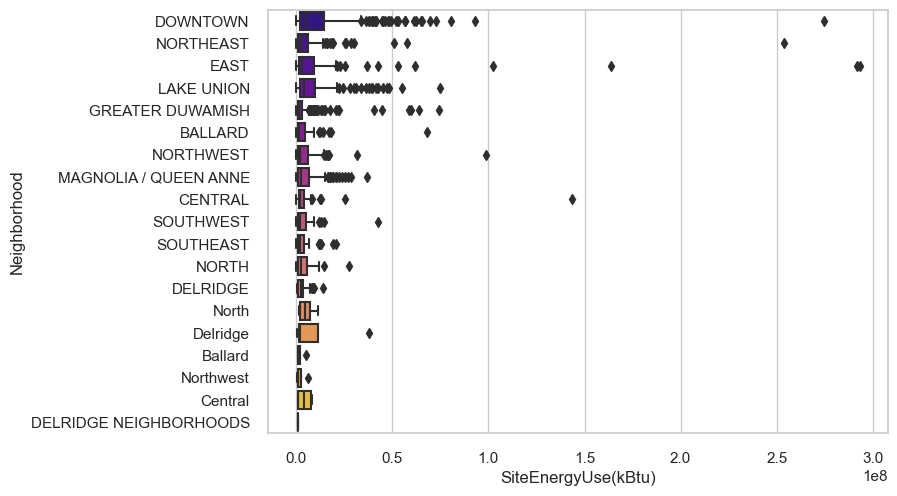

In [305]:
sns.boxplot(x='SiteEnergyUse(kBtu)', y='Neighborhood',data=data, palette='plasma')

__consommation d'énergie en fonction du nombre de bâtiments__

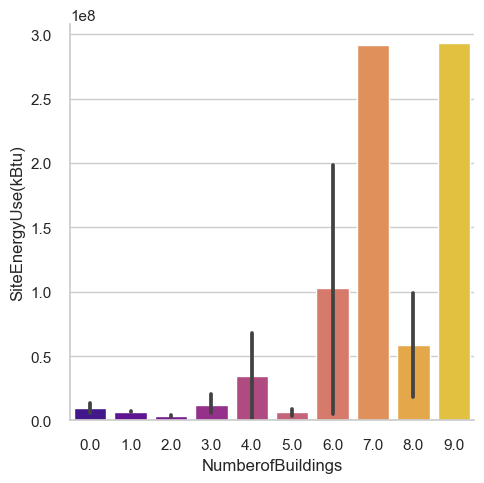

In [306]:
### SiteEnergyUse en Fonction du Nombre de Batiments
sns.catplot( y="SiteEnergyUse(kBtu)",  x="NumberofBuildings", kind="bar", data=data,  palette='plasma')

## Ne retenir que les variables pertinentes 

Pour la suite (corrélations,apurement et modelisation), nous n'allons retenir que les variables que nous jugerons utiles à la prédiction.

In [307]:
#### ne garder que les variables utiles
data = data[['OSEBuildingID', 'BuildingType','PrimaryPropertyType','Neighborhood','YearBuilt',
                 'NumberofBuildings','NumberofFloors','PropertyGFATotal','PropertyGFAParking','PropertyGFABuilding(s)',
                 'LargestPropertyUseType','LargestPropertyUseTypeGFA','ENERGYSTARScore','SiteEUI(kBtu/sf)',
                 'SiteEnergyUse(kBtu)','SteamUse(kBtu)','Electricity(kBtu)','NaturalGas(kBtu)','TotalGHGEmissions', 'UseTypeNumber']]
data.shape

(1544, 20)

### corrélations entre variables

In [308]:
data.select_dtypes(include=[int, float]).corr(method="pearson")

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber
OSEBuildingID,1.000000,0.022767,-0.020590,-0.265114,-0.312878,-0.230163,-0.296423,-0.289094,-0.044585,-0.011903,-0.201122,-0.039367,-0.236111,-0.085210,-0.109496,-0.106937
YearBuilt,0.022767,1.000000,0.033743,0.104067,0.227673,0.293478,0.182986,0.195448,-0.047035,0.143054,0.153451,0.017784,0.181321,0.073118,0.079089,0.074371
NumberofBuildings,-0.020590,0.033743,1.000000,-0.006222,0.169500,-0.028032,0.200237,0.236761,-0.029852,0.054729,0.407859,0.376628,0.280785,0.347142,0.492798,0.000426
NumberofFloors,-0.265114,0.104067,-0.006222,1.000000,0.677513,0.501861,0.640983,0.645128,0.147491,0.015449,0.390639,0.104391,0.486483,0.071804,0.189162,0.190064
PropertyGFATotal,-0.312878,0.227673,0.169500,0.677513,1.000000,0.614710,0.978804,0.951051,0.141637,0.038645,0.638497,0.293013,0.678846,0.272076,0.457735,0.228574
PropertyGFAParking,-0.230163,0.293478,-0.028032,0.501861,0.614710,1.000000,0.440147,0.515788,0.116371,0.049574,0.257340,0.002777,0.340149,0.066687,0.090319,0.220242
PropertyGFABuilding(s),-0.296423,0.182986,0.200237,0.640983,0.978804,0.440147,1.000000,0.948733,0.132770,0.031082,0.660046,0.332844,0.684477,0.292415,0.497633,0.203026
LargestPropertyUseTypeGFA,-0.289094,0.195448,0.236761,0.645128,0.951051,0.515788,0.948733,1.000000,0.128757,0.029557,0.692494,0.400100,0.695324,0.311537,0.557424,0.144865
ENERGYSTARScore,-0.044585,-0.047035,-0.029852,0.147491,0.141637,0.116371,0.132770,0.128757,1.000000,-0.332728,-0.044095,-0.035069,0.005159,-0.122079,-0.084866,0.098103
SiteEUI(kBtu/sf),-0.011903,0.143054,0.054729,0.015449,0.038645,0.049574,0.031082,0.029557,-0.332728,1.000000,0.402640,0.094293,0.393278,0.322289,0.295376,0.085579


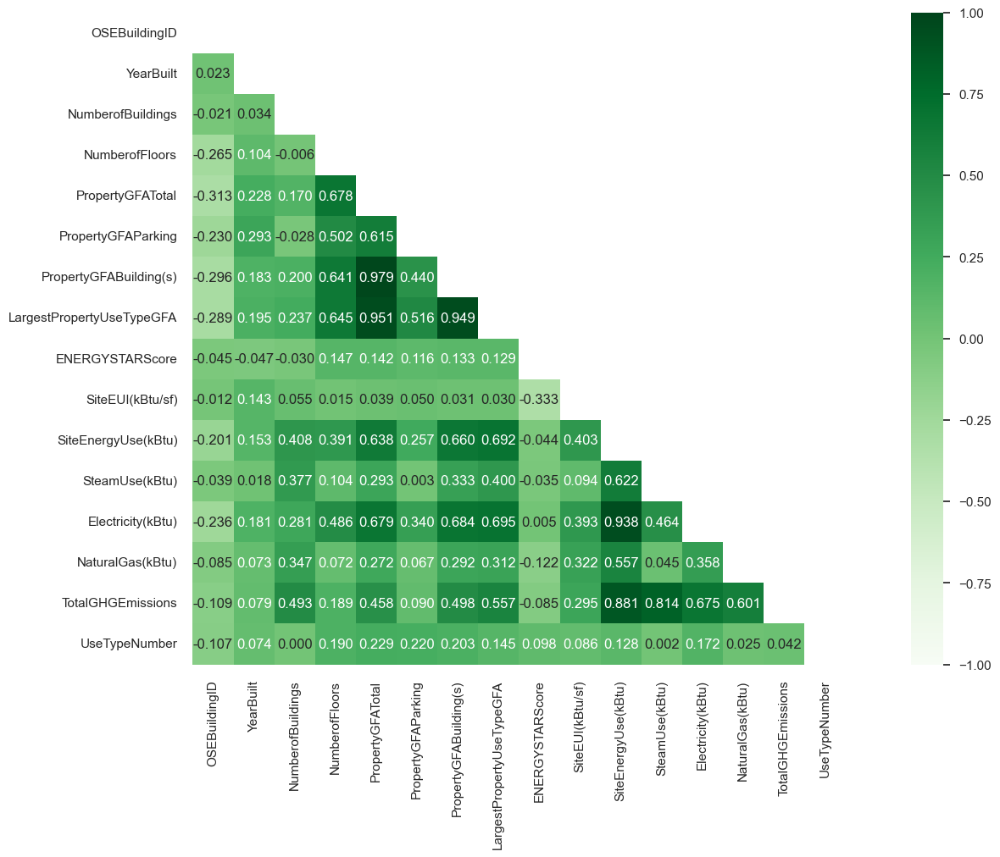

In [309]:
# correlation plot
plt.figure(figsize=(20, 10))
corr = data.select_dtypes(include=[int, float]).corr(method="pearson")
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr, cmap='Greens', annot=True, square=True,
            fmt='.3f',
            mask=mask,
            cbar=True, vmin=-1, vmax=1);

### Valeurs manquantes

<AxesSubplot:>

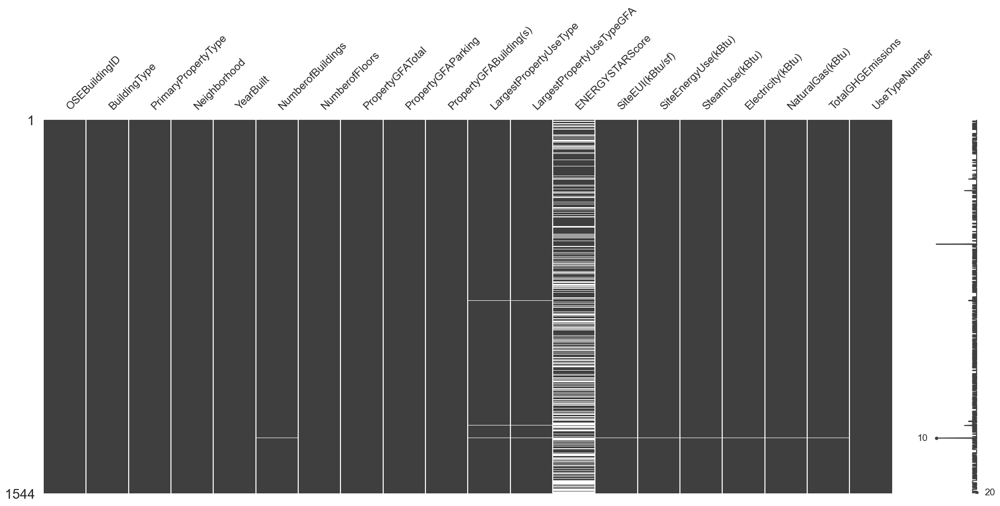

In [310]:
# Visualtisation des NAs
msno.matrix(data)

<AxesSubplot:>

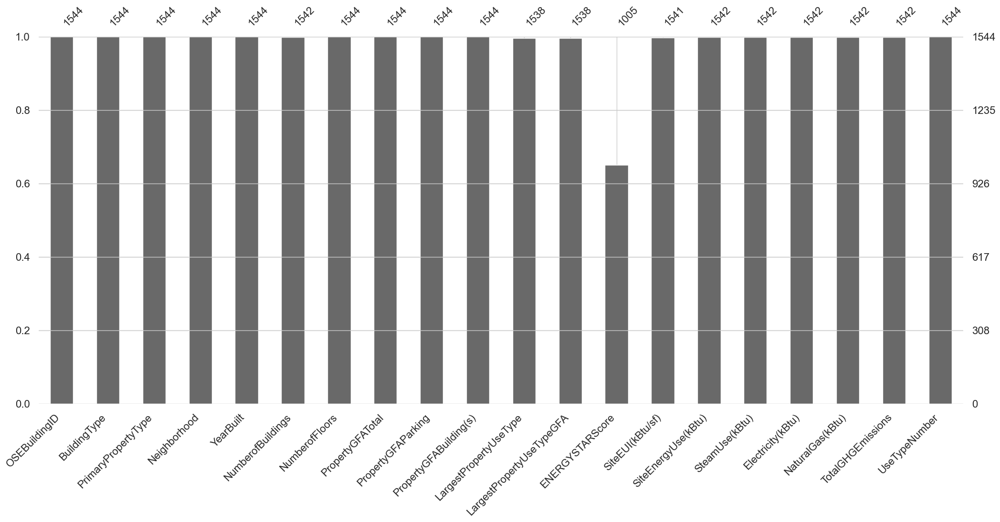

In [311]:
msno.bar(data)

In [312]:
# nombre de valeurs manquantes sur les variables retenues 
data.isna().sum().sort_values(ascending=False)

ENERGYSTARScore              539
LargestPropertyUseType         6
LargestPropertyUseTypeGFA      6
SiteEUI(kBtu/sf)               3
TotalGHGEmissions              2
NaturalGas(kBtu)               2
Electricity(kBtu)              2
NumberofBuildings              2
SteamUse(kBtu)                 2
SiteEnergyUse(kBtu)            2
OSEBuildingID                  0
BuildingType                   0
PropertyGFABuilding(s)         0
PropertyGFAParking             0
PropertyGFATotal               0
NumberofFloors                 0
YearBuilt                      0
Neighborhood                   0
PrimaryPropertyType            0
UseTypeNumber                  0
dtype: int64

### Résumé

In [313]:
# Generate a profile report from a Dataset stored as a pandas `DataFrame`.
profile = ProfileReport(data, title="Profiling Report")
profile.to_notebook_iframe()  # Used to output the HTML representation to a Jupyter notebook.

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [314]:
profile.to_file("data_report.html")  # Write the report to a file.

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

**<h1 style="color:#06344ef6;text-align:center;font-size:35px;font-family:Bodoni MT"> II- Apurement & Feature Engineering </h1>**


Dans cette partie, nous effectuerons, dans un premier temps l'apurement, de la base retenue notamment le traitement des valeurs manquantes, des outliers, verification de doublons existants etc... 
En second lieu, nous procéderons au pretraitement des variables pour la modélisation dont le recodage, la création de nouvelles variables pertinentes, la sélection des variables explicatives etc...

## Traitement des valeurs manquantes

Au vue de la partie qui précède, nous voyons que la moitié du dataset contient de faibles pourcentages de valeurs manquantes sauf pour ENERGYSTARScore.
Nous allons imputer cette dernière avec la méthode KNN. 

A préciser que les valeurs manquantes de la variable cible (SiteEnergyUse(kBtu) seront supprimées car l'imputer n'est pas recommandé d'autant plus qu'il n'y a en que 2 au total.

In [315]:
# supprimer les lignes nan de SiteEnergyUse(kBtu)
data = data.dropna(subset=['SiteEnergyUse(kBtu)'])
data.shape

(1542, 20)

In [316]:
data.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.538000e+03,1005.000000,1541.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.036316,4.287289,1.119589e+05,13835.432555,9.812344e+04,9.048857e+04,63.861692,74.283842,7.650918e+06,4.957909e+05,5.432400e+06,1.672004e+06,164.940655,1.938392
std,13859.126565,32.891191,0.569599,6.791401,1.917212e+05,43728.637815,1.684131e+05,1.562910e+05,28.912800,75.604224,1.866900e+07,5.309536e+06,1.304580e+07,5.508058e+06,571.108801,1.204886
min,1.000000,1900.000000,0.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,-1.154170e+05,0.000000e+00,-0.800000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.462925e+04,44.000000,34.299999,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,71.000000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.864600e+04,89.000000,83.800003,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000
max,50226.000000,2015.000000,9.000000,99.000000,1.952220e+06,512608.000000,1.765970e+06,1.680937e+06,100.000000,834.400024,2.930908e+08,1.349435e+08,2.745325e+08,1.381912e+08,12307.160000,13.000000


In [317]:
# nombre de valeurs manquantes apres suppression des 2 Nan de la variable cible
data.isna().sum().sort_values(ascending=False)

ENERGYSTARScore              537
LargestPropertyUseType         4
LargestPropertyUseTypeGFA      4
SiteEUI(kBtu/sf)               1
BuildingType                   0
TotalGHGEmissions              0
NaturalGas(kBtu)               0
Electricity(kBtu)              0
SteamUse(kBtu)                 0
SiteEnergyUse(kBtu)            0
OSEBuildingID                  0
PropertyGFABuilding(s)         0
PropertyGFAParking             0
PropertyGFATotal               0
NumberofFloors                 0
NumberofBuildings              0
YearBuilt                      0
Neighborhood                   0
PrimaryPropertyType            0
UseTypeNumber                  0
dtype: int64

On voit qu'il ne reste quasiment plus que l'ENERGYSTARScore. Les 2 variables quantitatives restantes seront imputée par la médiane et celle quantitative par le mode.

In [318]:
# detection de doublons
data.duplicated().sum()

0

Aucun doublon détecté

### imputation de ENERGYSTARScore (KNN)

In [319]:
# creer une variable qui calcule l'age du batiments pour voir l'ancienneté (l'etude s'est fait en 2016)
data = data.assign(Age_building =2016-data['YearBuilt'])
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1542 entries, 0 to 3375
Data columns (total 21 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   OSEBuildingID              1542 non-null   int64  
 1   BuildingType               1542 non-null   object 
 2   PrimaryPropertyType        1542 non-null   object 
 3   Neighborhood               1542 non-null   object 
 4   YearBuilt                  1542 non-null   int64  
 5   NumberofBuildings          1542 non-null   float64
 6   NumberofFloors             1542 non-null   int64  
 7   PropertyGFATotal           1542 non-null   int64  
 8   PropertyGFAParking         1542 non-null   int64  
 9   PropertyGFABuilding(s)     1542 non-null   int64  
 10  LargestPropertyUseType     1538 non-null   object 
 11  LargestPropertyUseTypeGFA  1538 non-null   float64
 12  ENERGYSTARScore            1005 non-null   float64
 13  SiteEUI(kBtu/sf)           1541 non-null   float

In [320]:
# selectionner les variables à utiliser pour l'imputation
selected_columns = ['ENERGYSTARScore', 'TotalGHGEmissions', 
                    'NumberofBuildings', 'SiteEnergyUse(kBtu)', 'NumberofFloors', 'Age_building']
X_knn = data[selected_columns]
X_knn.head()

,ENERGYSTARScore,TotalGHGEmissions,NumberofBuildings,SiteEnergyUse(kBtu),NumberofFloors,Age_building
0,60.0,249.98,1.0,7226362.5,12,89
1,61.0,295.86,1.0,8387933.0,11,20
2,43.0,2089.28,1.0,72587024.0,41,47
3,56.0,286.43,1.0,6794584.0,10,90
4,75.0,505.01,1.0,14172606.0,18,36


In [321]:
### Imputation des NaN par les K plus proches voisins
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=5) # nbre de voisins
X_knn_imput_np = imputer.fit_transform(X_knn)

# Recréer un DataFrame pandas avec les données imputées
X_knn_imput = pd.DataFrame(X_knn_imput_np, columns=X_knn.columns)
X_knn_imput.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1542 entries, 0 to 1541
Data columns (total 6 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ENERGYSTARScore      1542 non-null   float64
 1   TotalGHGEmissions    1542 non-null   float64
 2   NumberofBuildings    1542 non-null   float64
 3   SiteEnergyUse(kBtu)  1542 non-null   float64
 4   NumberofFloors       1542 non-null   float64
 5   Age_building         1542 non-null   float64
dtypes: float64(6)
memory usage: 72.4 KB


In [322]:
# Comparaison des indicateurs avant et après imputation
# summary des 2
original_stats = X_knn['ENERGYSTARScore'].describe()
imputed_stats = X_knn_imput['ENERGYSTARScore'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'ENERGYSTARScore_Initial': original_stats,
    'ENERGYSTARScore_Impute': imputed_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       ENERGYSTARScore_Initial  ENERGYSTARScore_Impute
count              1005.000000             1542.000000
mean                 63.861692               64.147601
std                  28.912800               25.042557
min                   1.000000                1.000000
25%                  44.000000               49.650000
50%                  71.000000               68.200000
75%                  89.000000               83.950000
max                 100.000000              100.000000


L'imputation n'a pas changé les indicateurs initiaux de façon significative. Nous pouvons donc remplacer l'ancienne par la colonne imputée

In [323]:
# remplacer la variable initiale ENERGYSTARScore par la nouvelle imputée
data['ENERGYSTARScore'] = X_knn_imput['ENERGYSTARScore'].values
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1542 entries, 0 to 3375
Data columns (total 21 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   OSEBuildingID              1542 non-null   int64  
 1   BuildingType               1542 non-null   object 
 2   PrimaryPropertyType        1542 non-null   object 
 3   Neighborhood               1542 non-null   object 
 4   YearBuilt                  1542 non-null   int64  
 5   NumberofBuildings          1542 non-null   float64
 6   NumberofFloors             1542 non-null   int64  
 7   PropertyGFATotal           1542 non-null   int64  
 8   PropertyGFAParking         1542 non-null   int64  
 9   PropertyGFABuilding(s)     1542 non-null   int64  
 10  LargestPropertyUseType     1538 non-null   object 
 11  LargestPropertyUseTypeGFA  1538 non-null   float64
 12  ENERGYSTARScore            1542 non-null   float64
 13  SiteEUI(kBtu/sf)           1541 non-null   float

<AxesSubplot:>

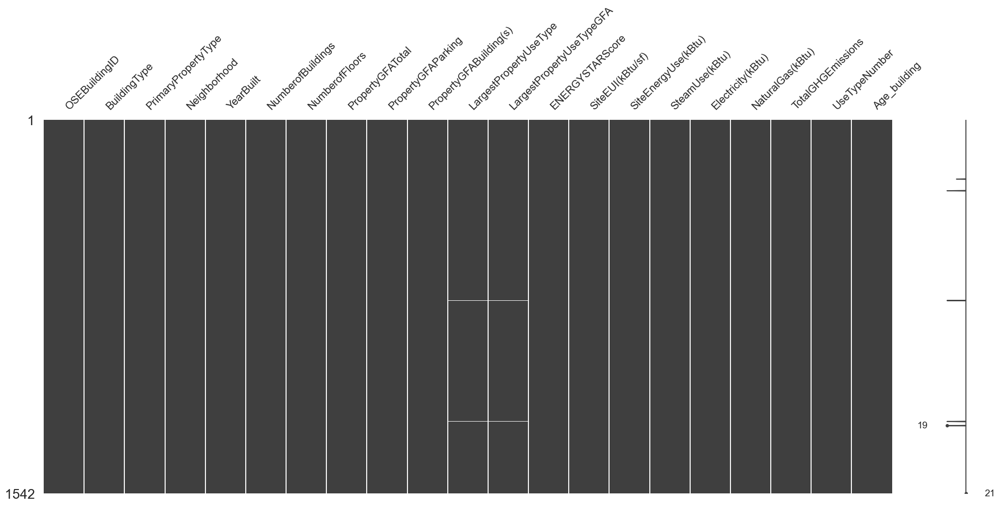

In [324]:
msno.matrix(data)

### imputation par la médiane 

In [325]:
# LargestPropertyUseTypeGFA
median_LPU = data['LargestPropertyUseTypeGFA'].median()
# Imputer les valeurs manquantes par la médiane
data['LargestPropertyUseTypeGFA'] = data['LargestPropertyUseTypeGFA'].fillna(median_LPU)

In [326]:
# SiteEUI(kBtu/sf)
median_SiteEUI = data['SiteEUI(kBtu/sf)'].median()
# Imputer les valeurs manquantes par la médiane
data['SiteEUI(kBtu/sf)'] = data['SiteEUI(kBtu/sf)'].fillna(median_SiteEUI)

In [327]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1542 entries, 0 to 3375
Data columns (total 21 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   OSEBuildingID              1542 non-null   int64  
 1   BuildingType               1542 non-null   object 
 2   PrimaryPropertyType        1542 non-null   object 
 3   Neighborhood               1542 non-null   object 
 4   YearBuilt                  1542 non-null   int64  
 5   NumberofBuildings          1542 non-null   float64
 6   NumberofFloors             1542 non-null   int64  
 7   PropertyGFATotal           1542 non-null   int64  
 8   PropertyGFAParking         1542 non-null   int64  
 9   PropertyGFABuilding(s)     1542 non-null   int64  
 10  LargestPropertyUseType     1538 non-null   object 
 11  LargestPropertyUseTypeGFA  1542 non-null   float64
 12  ENERGYSTARScore            1542 non-null   float64
 13  SiteEUI(kBtu/sf)           1542 non-null   float

### imputation par le mode

In [328]:
# Calculer le mode de la colonne 'LargestPropertyUseType'
mode_value = data['LargestPropertyUseType'].mode()[0]

# Imputer les valeurs manquantes de 'LargestPropertyUseTypeGFA' par le mode
data['LargestPropertyUseType'] = data['LargestPropertyUseType'].fillna(mode_value)

In [329]:
# Vérification
data.isna().sum().sort_values(ascending=False)

OSEBuildingID                0
LargestPropertyUseTypeGFA    0
UseTypeNumber                0
TotalGHGEmissions            0
NaturalGas(kBtu)             0
Electricity(kBtu)            0
SteamUse(kBtu)               0
SiteEnergyUse(kBtu)          0
SiteEUI(kBtu/sf)             0
ENERGYSTARScore              0
LargestPropertyUseType       0
BuildingType                 0
PropertyGFABuilding(s)       0
PropertyGFAParking           0
PropertyGFATotal             0
NumberofFloors               0
NumberofBuildings            0
YearBuilt                    0
Neighborhood                 0
PrimaryPropertyType          0
Age_building                 0
dtype: int64

Plus de valeurs manquantes

## Traitement des incohérences

In [330]:
data.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.036316,4.287289,1.119589e+05,13835.432555,9.812344e+04,9.036088e+04,64.147601,74.270169,7.650918e+06,4.957909e+05,5.432400e+06,1.672004e+06,164.940655,1.938392,54.717250
std,13859.126565,32.891191,0.569599,6.791401,1.917212e+05,43728.637815,1.684131e+05,1.561081e+05,25.042557,75.581596,1.866900e+07,5.309536e+06,1.304580e+07,5.508058e+06,571.108801,1.204886,32.891191
min,1.000000,1900.000000,0.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,-1.154170e+05,0.000000e+00,-0.800000,1.000000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.476625e+04,49.650000,34.325000,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000,28.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,68.200000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000,51.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.847600e+04,83.950000,83.775002,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000,87.000000
max,50226.000000,2015.000000,9.000000,99.000000,1.952220e+06,512608.000000,1.765970e+06,1.680937e+06,100.000000,834.400024,2.930908e+08,1.349435e+08,2.745325e+08,1.381912e+08,12307.160000,13.000000,116.000000


Nous pouvons constater quelques incohérence ici notamment des nombres de batiments (au sein d'un building) nulles, des valeurs négatives des quantités d'électricité consommées et de la quantité totale d'émissions de gaz à effet de serre

In [331]:
# correction de number of buildings 
# Remplacer les valeurs égales à zéro par la médiane (1)
data['NumberofBuildings'] = data['NumberofBuildings'].replace(0, data['NumberofBuildings'].median())
data.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.070039,4.287289,1.119589e+05,13835.432555,9.812344e+04,9.036088e+04,64.147601,74.270169,7.650918e+06,4.957909e+05,5.432400e+06,1.672004e+06,164.940655,1.938392,54.717250
std,13859.126565,32.891191,0.535826,6.791401,1.917212e+05,43728.637815,1.684131e+05,1.561081e+05,25.042557,75.581596,1.866900e+07,5.309536e+06,1.304580e+07,5.508058e+06,571.108801,1.204886,32.891191
min,1.000000,1900.000000,1.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,-1.154170e+05,0.000000e+00,-0.800000,1.000000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.476625e+04,49.650000,34.325000,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000,28.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,68.200000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000,51.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.847600e+04,83.950000,83.775002,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000,87.000000
max,50226.000000,2015.000000,9.000000,99.000000,1.952220e+06,512608.000000,1.765970e+06,1.680937e+06,100.000000,834.400024,2.930908e+08,1.349435e+08,2.745325e+08,1.381912e+08,12307.160000,13.000000,116.000000


In [332]:
# Electricity
data[data['Electricity(kBtu)'] < 0]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
3206,49784,NonResidential,Small- and Mid-Sized Office,CENTRAL,2013,1.0,6,52000,0,52000,Office,48159.0,100.0,7.1,342726.0938,0.0,-115417.0,0.0,-0.8,1,3


Le building avec des valeurs de consommation d'electricité negatif est un batiment de 3ans avec 6 etages utilisé principalement comme immeuble administratif. Donc on va supposer qu'il y a eu erreur de saisie en remettre la valeur positive d'autant plus qu'elle est proche de la moyenne (donc pas changement consequent)

In [333]:
# prendre la valeur absolu
data['Electricity(kBtu)'] = data['Electricity(kBtu)'].abs()
data.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.070039,4.287289,1.119589e+05,13835.432555,9.812344e+04,9.036088e+04,64.147601,74.270169,7.650918e+06,4.957909e+05,5.432550e+06,1.672004e+06,164.940655,1.938392,54.717250
std,13859.126565,32.891191,0.535826,6.791401,1.917212e+05,43728.637815,1.684131e+05,1.561081e+05,25.042557,75.581596,1.866900e+07,5.309536e+06,1.304574e+07,5.508058e+06,571.108801,1.204886,32.891191
min,1.000000,1900.000000,1.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,-0.800000,1.000000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.476625e+04,49.650000,34.325000,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000,28.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,68.200000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000,51.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.847600e+04,83.950000,83.775002,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000,87.000000
max,50226.000000,2015.000000,9.000000,99.000000,1.952220e+06,512608.000000,1.765970e+06,1.680937e+06,100.000000,834.400024,2.930908e+08,1.349435e+08,2.745325e+08,1.381912e+08,12307.160000,13.000000,116.000000


In [334]:
# TotalGHGEmissions
data[data['TotalGHGEmissions'] < 0]
# le meme batiment que precedemment, on fera le meme traitement

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
3206,49784,NonResidential,Small- and Mid-Sized Office,CENTRAL,2013,1.0,6,52000,0,52000,Office,48159.0,100.0,7.1,342726.0938,0.0,115417.0,0.0,-0.8,1,3


In [335]:
# prendre la valeur absolu
data['TotalGHGEmissions'] = data['TotalGHGEmissions'].abs()
data.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.070039,4.287289,1.119589e+05,13835.432555,9.812344e+04,9.036088e+04,64.147601,74.270169,7.650918e+06,4.957909e+05,5.432550e+06,1.672004e+06,164.941693,1.938392,54.717250
std,13859.126565,32.891191,0.535826,6.791401,1.917212e+05,43728.637815,1.684131e+05,1.561081e+05,25.042557,75.581596,1.866900e+07,5.309536e+06,1.304574e+07,5.508058e+06,571.108501,1.204886,32.891191
min,1.000000,1900.000000,1.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,1.000000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.476625e+04,49.650000,34.325000,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000,28.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,68.200000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000,51.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.847600e+04,83.950000,83.775002,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000,87.000000
max,50226.000000,2015.000000,9.000000,99.000000,1.952220e+06,512608.000000,1.765970e+06,1.680937e+06,100.000000,834.400024,2.930908e+08,1.349435e+08,2.745325e+08,1.381912e+08,12307.160000,13.000000,116.000000


## Traitement des outliers

Une valeur aberrante, également connue sous le nom d'outlier en statistiques, est une observation qui se situe à une distance significative des autres valeurs dans un ensemble de données. 
Nous développerons dans la suite la methode adoptée pour leur correction.

In [336]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1542 entries, 0 to 3375
Data columns (total 21 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   OSEBuildingID              1542 non-null   int64  
 1   BuildingType               1542 non-null   object 
 2   PrimaryPropertyType        1542 non-null   object 
 3   Neighborhood               1542 non-null   object 
 4   YearBuilt                  1542 non-null   int64  
 5   NumberofBuildings          1542 non-null   float64
 6   NumberofFloors             1542 non-null   int64  
 7   PropertyGFATotal           1542 non-null   int64  
 8   PropertyGFAParking         1542 non-null   int64  
 9   PropertyGFABuilding(s)     1542 non-null   int64  
 10  LargestPropertyUseType     1542 non-null   object 
 11  LargestPropertyUseTypeGFA  1542 non-null   float64
 12  ENERGYSTARScore            1542 non-null   float64
 13  SiteEUI(kBtu/sf)           1542 non-null   float

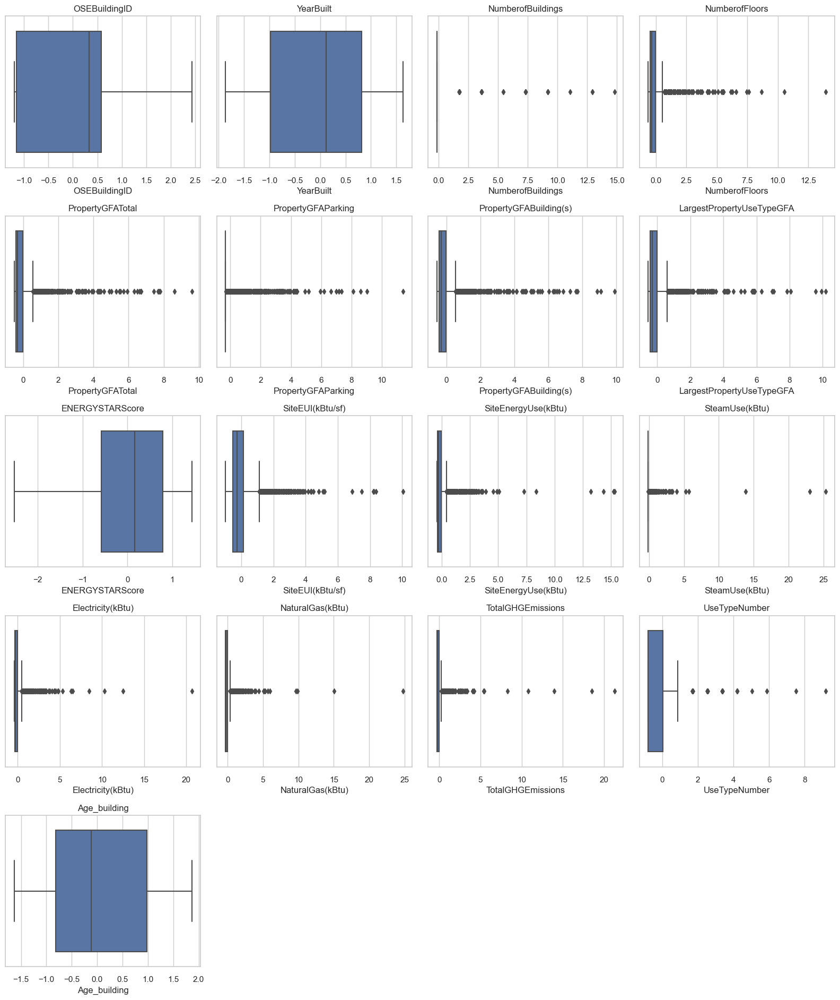

In [337]:
# voir les boxplots (avec les variables normalisées)
from sklearn.preprocessing import StandardScaler

# Sélectionner uniquement les colonnes numériques
numeric_columns = data.select_dtypes(include=['float64', 'int64'])

# Normaliser les données
scaler = StandardScaler()
normalized_data = scaler.fit_transform(numeric_columns)

# Convertir les données normalisées en DataFrame pour maintenir les noms de colonnes
normalized_df = pd.DataFrame(normalized_data, columns=numeric_columns.columns)

# tracer les box plots
plt.figure(figsize=(16, 19))
for i, column in enumerate(normalized_df.columns):
    plt.subplot(5, 4, i + 1)  
    sns.boxplot(x=normalized_df[column])
    plt.title(column)

plt.tight_layout()
plt.show()


Nous constatons ici que beaucoup de variables avec des valeurs qui semblent aberantes, entre autres l'emission de Gaz a effet de serre, la quantité de vapeur consommée, le nombre d'étages, la quantité d'éléctricité consommée etc...

Nous utiliserons la méthode de winsorisation pour corriger les valeurs jugées aberantes.


La winsorisation est une technique de traitement des valeurs aberrantes qui consiste à ajuster les valeurs extrêmes d'un ensemble de données à des seuils spécifiques plutôt que de les supprimer. 

Elle fonctionne de la manière suivante :

- fixer un seuil supérieur (Winsorizing vers le haut) :
On fixe un seuil supérieur au-delà duquel toutes les valeurs seront ajustées. Par exemple, on peut choisirde fixer le seuil supérieur au 95e percentile de la distribution (la valeur en dessous de laquelle 95% des données se trouvent).

- fixer un seuil inférieur (Winsorizing vers le bas) :
On fixe un seuil inférieur en deçà duquel toutes les valeurs seront ajustées. 

- Ajustement des valeurs :
Toutes les valeurs qui dépassent le seuil supérieur sont remplacées par la valeur correspondant au seuil supérieur.
De même, toutes les valeurs inférieures au seuil inférieur sont remplacées par la valeur correspondant au seuil inférieur.

Dans notre cas, les valeurs abérantes se trouvent au niveau supérieur, ce qui fait qu'on va winsorizer vers le haut avec un seuil fixé selon la distribution de la variable.

In [338]:
data1 = data.copy()

- __NumberofBuildings__

In [339]:
data['NumberofBuildings'].max()

9.0

In [340]:
data[data['NumberofBuildings']>data['NumberofBuildings'].quantile(0.995)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
124,198,NonResidential,Hospital,NORTHEAST,1953,6.0,10,879000,0,879000,Hospital (General Medical & Surgical),879000.0,10.0,288.799988,2.538325e+08,0.0,115641210.0,138191238.0,8145.52,1,63
167,268,NonResidential,Hospital,CENTRAL,1990,6.0,5,597519,0,597519,Hospital (General Medical & Surgical),601615.0,34.0,238.399994,1.434230e+08,0.0,58754927.0,84668094.0,4906.33,2,26
170,276,NonResidential,Hospital,EAST,2000,9.0,8,1158691,0,1158691,Hospital (General Medical & Surgical),1350182.0,29.0,217.100006,2.930908e+08,122575032.0,168683602.0,1832129.0,10734.57,2,16
364,516,NonResidential,Other,NORTHWEST,1964,6.0,1,111900,0,111900,Strip Mall,124231.0,48.6,79.000000,9.814820e+06,0.0,6390148.0,3424670.0,226.43,2,52
618,828,NonResidential,Hospital,EAST,1994,7.0,14,1765970,0,1765970,Hospital (General Medical & Surgical),1639334.0,54.0,177.899994,2.916144e+08,134943456.0,139354828.0,17316120.0,12307.16,2,22
1672,23071,NonResidential,Hospital,NORTHWEST,1966,8.0,1,415632,0,415632,Hospital (General Medical & Surgical),483520.0,85.0,204.699997,9.896078e+07,0.0,42864158.0,56096612.0,3278.11,2,50
2901,27389,NonResidential,Small- and Mid-Sized Office,CENTRAL,1956,6.0,2,75868,0,75868,Office,50379.0,49.6,47.500000,3.605750e+06,0.0,3605750.0,0.0,25.14,4,60
3168,49705,Nonresidential COS,Other,NORTHEAST,1929,8.0,0,502030,0,502030,Other - Recreation,564258.0,60.8,32.700001,1.847034e+07,0.0,9359884.0,9110455.0,549.11,1,87


Nous voyons que les batiments ayant les grands nombre de sous_batiments constituent principalement les hopitaux ce qui peut être assez comprehensible. Donc on va decider conserver ces valeurs et les considérer comme extremes mais vraies.

- __NumberofFloors__             

In [341]:
data['NumberofFloors'].max()

99

In [342]:
data[data['NumberofFloors']>data['NumberofFloors'].quantile(0.999)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
559,775,NonResidential,Large Office,DOWNTOWN,1985,1.0,76,1952220,319400,1632820,Office,1680937.0,86.0,55.299999,9.293764e+07,0.0,87851862.0,5085763.0,882.56,2,31
1359,21611,NonResidential,Worship Facility,GREATER DUWAMISH,1977,1.0,99,21948,0,21948,Worship Facility,21948.0,80.0,14.900000,3.260012e+05,0.0,326001.0,0.0,2.27,1,39


In [343]:
# correction (Les valeurs au-delà du 99.9e percentile seront ajustées)
data1['NumberofFloors'] = winsorize(data1['NumberofFloors'], limits=(0, 0.001))
# Comparaison des indicateurs avant et après correction
# summary des 2
original_stats = data['NumberofFloors'].describe()
correction_stats = data1['NumberofFloors'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'NumberofFloors_Initial': original_stats,
    'NumberofFloors_corrigé': correction_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       NumberofFloors_Initial  NumberofFloors_corrigé
count             1542.000000             1542.000000
mean                 4.287289                4.272374
std                  6.791401                6.605977
min                  0.000000                0.000000
25%                  1.000000                1.000000
50%                  2.000000                2.000000
75%                  4.000000                4.000000
max                 99.000000               76.000000


- __PropertyGFATotal__                      

In [344]:
data['PropertyGFATotal'].max()

1952220

In [345]:
data[data['PropertyGFATotal']>data['PropertyGFATotal'].quantile(0.998)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
292,422,NonResidential,Large Office,DOWNTOWN,1989,1.0,56,1605578,389860,1215718,Office,1314475.0,97.0,36.799999,49517704.0,9.156549e+05,46081813.0,2520230.0,525.78,3,27
490,659,NonResidential,Large Office,DOWNTOWN,2005,1.0,42,1592914,0,1592914,Office,914832.0,97.0,45.299999,56498868.0,9.864032e+05,55123924.0,388532.0,481.06,5,11
559,775,NonResidential,Large Office,DOWNTOWN,1985,1.0,76,1952220,319400,1632820,Office,1680937.0,86.0,55.299999,92937640.0,0.000000e+00,87851862.0,5085763.0,882.56,2,31
618,828,NonResidential,Hospital,EAST,1994,7.0,14,1765970,0,1765970,Hospital (General Medical & Surgical),1639334.0,54.0,177.899994,291614432.0,1.349435e+08,139354828.0,17316120.0,12307.16,2,22


In [346]:
# correction (Les valeurs au-delà du 99.8e percentile seront ajustées)
data1['PropertyGFATotal'] = winsorize(data1['PropertyGFATotal'], limits=(0, 0.002))
# Comparaison des indicateurs avant et après correction
# summary des 2
original_stats = data['PropertyGFATotal'].describe()
correction_stats = data1['PropertyGFATotal'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'PropertyGFATotal_Initial': original_stats,
    'PropertyGFATotal_corrigé': correction_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       PropertyGFATotal_Initial  PropertyGFATotal_corrigé
count              1.542000e+03              1.542000e+03
mean               1.119589e+05              1.116054e+05
std                1.917212e+05              1.886955e+05
min                1.128500e+04              1.128500e+04
25%                2.877000e+04              2.877000e+04
50%                4.730250e+04              4.730250e+04
75%                1.029825e+05              1.029825e+05
max                1.952220e+06              1.592914e+06


- __PropertyGFAParking__ 
- __PropertyGFABuilding(s)__
- __LargestPropertyUseTypeGFA__                  

In [347]:
# Liste des colonnes à winsoriser
colonnes_winsoriser = ['PropertyGFAParking', 'PropertyGFABuilding(s)', 'LargestPropertyUseTypeGFA']

# Winsorisation pour chaque colonne
for colonne in colonnes_winsoriser:
    data1[colonne] = winsorize(data1[colonne], limits=(0, 0.002))

- __SiteEUI(kBtu/sf)__                       

In [348]:
data['SiteEUI(kBtu/sf)'].max()

834.4000244

In [349]:
data[data['SiteEUI(kBtu/sf)']>data['SiteEUI(kBtu/sf)'].quantile(0.999)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
240,365,NonResidential,Other,NORTHEAST,1969,1.0,5,36000,0,36000,Data Center,36000.0,96.0,834.400024,30038490.0,0.0,30038487.0,0.0,209.41,1,47
309,440,NonResidential,Mixed Use Property,LAKE UNION,2001,1.0,6,213834,104922,108912,Parking,104922.0,100.0,707.299988,75073888.0,0.0,74917352.0,156525.0,530.59,6,15


In [350]:
# correction (Les valeurs au-delà du 99.9e percentile seront ajustées)
data1['SiteEUI(kBtu/sf)'] = winsorize(data1['SiteEUI(kBtu/sf)'], limits=(0, 0.001))
# Comparaison des indicateurs avant et après correction
# summary des 2
original_stats = data['SiteEUI(kBtu/sf)'].describe()
correction_stats = data1['SiteEUI(kBtu/sf)'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'SiteEUI(kBtu/sf)_Initial': original_stats,
    'SiteEUI(kBtu/sf)_corrigé': correction_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       SiteEUI(kBtu/sf)_Initial  SiteEUI(kBtu/sf)_corrigé
count               1542.000000               1542.000000
mean                  74.270169                 74.187743
std                   75.581596                 74.817541
min                    0.000000                  0.000000
25%                   34.325000                 34.325000
50%                   53.200001                 53.200001
75%                   83.775002                 83.775002
max                  834.400024                707.299988


- __SiteEnergyUse(kBtu)__                       

In [351]:
data['SiteEnergyUse(kBtu)'].max()

293090784.0

In [352]:
data[data['SiteEnergyUse(kBtu)']>data['SiteEnergyUse(kBtu)'].quantile(0.998)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
124,198,NonResidential,Hospital,NORTHEAST,1953,6.0,10,879000,0,879000,Hospital (General Medical & Surgical),879000.0,10.0,288.799988,253832464.0,0.0,115641210.0,138191238.0,8145.52,1,63
170,276,NonResidential,Hospital,EAST,2000,9.0,8,1158691,0,1158691,Hospital (General Medical & Surgical),1350182.0,29.0,217.100006,293090784.0,122575032.0,168683602.0,1832129.0,10734.57,2,16
558,753,NonResidential,Other,DOWNTOWN,1981,1.0,33,429405,0,429405,Data Center,218997.0,98.0,639.700012,274682208.0,0.0,274532495.0,149672.0,1921.82,2,35
618,828,NonResidential,Hospital,EAST,1994,7.0,14,1765970,0,1765970,Hospital (General Medical & Surgical),1639334.0,54.0,177.899994,291614432.0,134943456.0,139354828.0,17316120.0,12307.16,2,22


In [353]:
# correction (Les valeurs au-delà du 99.8e percentile seront ajustées)
data1['SiteEnergyUse(kBtu)'] = winsorize(data1['SiteEnergyUse(kBtu)'], limits=(0, 0.002))
# Comparaison des indicateurs avant et après correction
# summary des 2
original_stats = data['SiteEnergyUse(kBtu)'].describe()
correction_stats = data1['SiteEnergyUse(kBtu)'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'SiteEnergyUse(kBtu)_Initial': original_stats,
    'SiteEnergyUse(kBtu)_corrigé': correction_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       SiteEnergyUse(kBtu)_Initial  SiteEnergyUse(kBtu)_corrigé
count                 1.542000e+03                 1.542000e+03
mean                  7.650918e+06                 7.587435e+06
std                   1.866900e+07                 1.774943e+07
min                   0.000000e+00                 0.000000e+00
25%                   1.206500e+06                 1.206500e+06
50%                   2.615611e+06                 2.615611e+06
75%                   6.978706e+06                 6.978706e+06
max                   2.930908e+08                 2.538325e+08


-   SteamUse(kBtu)           
- Electricity(kBtu)        
- NaturalGas(kBtu)        

In [354]:
# Liste des colonnes à winsoriser
colonnes_winsoriser = ['SteamUse(kBtu)', 'Electricity(kBtu)', 'NaturalGas(kBtu)']

# Winsorisation pour chaque colonne
for colonne in colonnes_winsoriser:
    data1[colonne] = winsorize(data1[colonne], limits=(0, 0.005))
data1.describe()

,OSEBuildingID,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
count,1542.000000,1542.000000,1542.000000,1542.000000,1.542000e+03,1542.000000,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1.542000e+03,1.542000e+03,1.542000e+03,1.542000e+03,1542.000000,1542.000000,1542.000000
mean,16595.957847,1961.282750,1.070039,4.272374,1.116054e+05,13703.575875,9.761001e+04,8.980596e+04,64.147601,74.187743,7.587435e+06,2.959540e+05,5.127372e+06,1.528227e+06,164.941693,1.938392,54.717250
std,13859.126565,32.891191,0.535826,6.605977,1.886955e+05,42471.306372,1.639475e+05,1.510265e+05,25.042557,74.817541,1.774943e+07,1.721714e+06,9.604610e+06,3.431402e+06,571.108501,1.204886,32.891191
min,1.000000,1900.000000,1.000000,0.000000,1.128500e+04,0.000000,3.636000e+03,5.656000e+03,1.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,1.000000,1.000000
25%,609.250000,1929.000000,1.000000,1.000000,2.877000e+04,0.000000,2.770000e+04,2.476625e+04,49.650000,34.325000,1.206500e+06,0.000000e+00,7.100620e+05,0.000000e+00,19.450000,1.000000,28.000000
50%,21212.500000,1965.000000,1.000000,2.000000,4.730250e+04,0.000000,4.511350e+04,4.126550e+04,68.200000,53.200001,2.615611e+06,0.000000e+00,1.633988e+06,4.348840e+05,48.425000,2.000000,51.000000
75%,24629.750000,1988.000000,1.000000,4.000000,1.029825e+05,0.000000,9.296300e+04,8.847600e+04,83.950000,83.775002,6.978706e+06,0.000000e+00,5.018711e+06,1.413123e+06,137.197500,2.000000,87.000000
max,50226.000000,2015.000000,9.000000,76.000000,1.592914e+06,368980.000000,1.400000e+06,1.350182e+06,100.000000,707.299988,2.538325e+08,1.754842e+07,6.863682e+07,3.006132e+07,12307.160000,13.000000,116.000000


- __TotalGHGEmissions__                       

In [355]:
data['TotalGHGEmissions'].max()

12307.16

In [356]:
data[data['TotalGHGEmissions']>data['TotalGHGEmissions'].quantile(0.995)]

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building
124,198,NonResidential,Hospital,NORTHEAST,1953,6.0,10,879000,0,879000,Hospital (General Medical & Surgical),879000.0,10.0,288.799988,253832464.0,0.0,115641210.0,138191238.0,8145.52,1,63
167,268,NonResidential,Hospital,CENTRAL,1990,6.0,5,597519,0,597519,Hospital (General Medical & Surgical),601615.0,34.0,238.399994,143423024.0,0.0,58754927.0,84668094.0,4906.33,2,26
170,276,NonResidential,Hospital,EAST,2000,9.0,8,1158691,0,1158691,Hospital (General Medical & Surgical),1350182.0,29.0,217.100006,293090784.0,122575032.0,168683602.0,1832129.0,10734.57,2,16
262,389,NonResidential,Hotel,DOWNTOWN,1923,1.0,12,542305,0,542305,Hotel,542305.0,45.0,104.199997,56485204.0,28438884.0,24078107.0,3968211.0,2573.75,2,93
618,828,NonResidential,Hospital,EAST,1994,7.0,14,1765970,0,1765970,Hospital (General Medical & Surgical),1639334.0,54.0,177.899994,291614432.0,134943456.0,139354828.0,17316120.0,12307.16,2,22
1672,23071,NonResidential,Hospital,NORTHWEST,1966,8.0,1,415632,0,415632,Hospital (General Medical & Surgical),483520.0,85.0,204.699997,98960776.0,0.0,42864158.0,56096612.0,3278.11,2,50
1690,23113,NonResidential,Medical Office,EAST,1964,1.0,3,591981,0,591981,Medical Office,520187.0,60.0,173.399994,102673696.0,0.0,48002292.0,54671394.0,3238.24,4,52
3264,49940,NonResidential,Hospital,EAST,1920,1.0,8,374466,0,374466,Hospital (General Medical & Surgical),1010135.0,74.0,162.300003,163945984.0,73885472.0,90060497.0,0.0,6330.91,1,96


In [357]:
# correction (Les valeurs au-delà du 99.9e percentile seront ajustées)
data1['TotalGHGEmissions'] = winsorize(data1['TotalGHGEmissions'], limits=(0, 0.005))
# Comparaison des indicateurs avant et après correction
# summary des 2
original_stats = data['TotalGHGEmissions'].describe()
correction_stats = data1['TotalGHGEmissions'].describe()

# Créer un DataFrame pour comparer les statistiques
comparaison = pd.DataFrame({
    'TotalGHGEmissions_Initial': original_stats,
    'TotalGHGEmissions_corrigé': correction_stats})

# Afficher le DataFrame de comparaison
print(comparaison)

       TotalGHGEmissions_Initial  TotalGHGEmissions_corrigé
count                1542.000000                1542.000000
mean                  164.941693                 144.886835
std                   571.108501                 301.563534
min                     0.000000                   0.000000
25%                    19.450000                  19.450000
50%                    48.425000                  48.425000
75%                   137.197500                 137.197500
max                 12307.160000                2573.750000


___Verification des corrections___


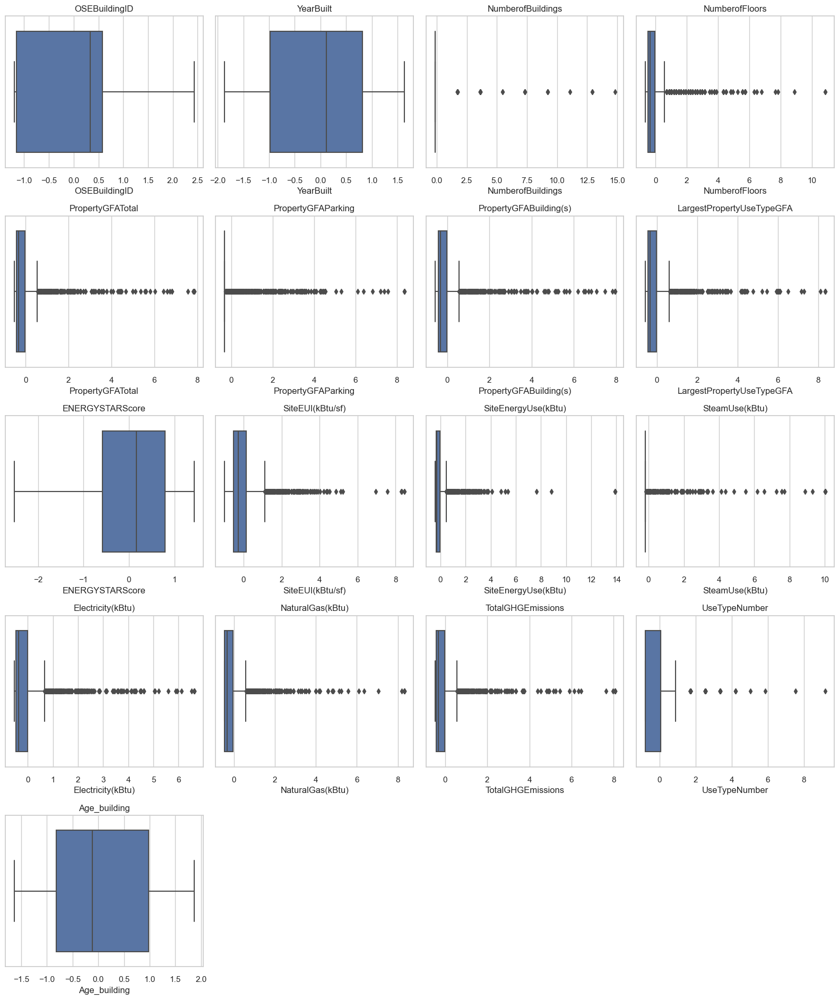

In [358]:
# voir les boxplots (avec les variables normalisées)
from sklearn.preprocessing import StandardScaler

# Sélectionner uniquement les colonnes numériques
numeric_columns = data1.select_dtypes(include=['float64', 'int64'])

# Normaliser les données
scaler = StandardScaler()
normalized_data = scaler.fit_transform(numeric_columns)

# Convertir les données normalisées en DataFrame pour maintenir les noms de colonnes
normalized_df = pd.DataFrame(normalized_data, columns=numeric_columns.columns)

# tracer les box plots
plt.figure(figsize=(16, 19))
for i, column in enumerate(normalized_df.columns):
    plt.subplot(5, 4, i + 1)  
    sns.boxplot(x=normalized_df[column])
    plt.title(column)

plt.tight_layout()
plt.show()


Plus de valeurs aberantes extrêmes (toutes inferieurs à 15).

## Recodage et création de variables

### Recodage des modalités des variables catégorielles

In [359]:
data1.describe(include="object")

,BuildingType,PrimaryPropertyType,Neighborhood,LargestPropertyUseType
count,1542,1542,1542,1542
unique,3,21,19,56
top,NonResidential,Small- and Mid-Sized Office,DOWNTOWN,Office
freq,1456,291,354,499


In [360]:
data1['LargestPropertyUseType'].unique()

array(['Hotel', 'Police Station', 'Other - Entertainment/Public Assembly',
       'Library', 'Fitness Center/Health Club/Gym', 'Social/Meeting Hall',
       'Courthouse', 'Other', 'College/University',
       'Automobile Dealership', 'Office', 'Self-Storage Facility',
       'Non-Refrigerated Warehouse', 'K-12 School', 'Other - Mall',
       'Senior Care Community', 'Medical Office', 'Retail Store',
       'Hospital (General Medical & Surgical)', 'Museum',
       'Repair Services (Vehicle, Shoe, Locksmith, etc)',
       'Other - Lodging/Residential', 'Residence Hall/Dormitory',
       'Other/Specialty Hospital', 'Financial Office',
       'Distribution Center', 'Parking', 'Multifamily Housing',
       'Worship Facility', 'Restaurant', 'Data Center', 'Laboratory',
       'Supermarket/Grocery Store', 'Convention Center',
       'Urgent Care/Clinic/Other Outpatient', 'Other - Services',
       'Strip Mall', 'Wholesale Club/Supercenter',
       'Refrigerated Warehouse', 'Manufacturing/Indu

In [361]:
data1['Neighborhood'].unique()

array(['DOWNTOWN', 'NORTHEAST', 'EAST', 'LAKE UNION', 'GREATER DUWAMISH',
       'BALLARD', 'NORTHWEST', 'MAGNOLIA / QUEEN ANNE', 'CENTRAL',
       'SOUTHWEST', 'SOUTHEAST', 'NORTH', 'DELRIDGE', 'North', 'Delridge',
       'Ballard', 'Northwest', 'Central', 'DELRIDGE NEIGHBORHOODS'],
      dtype=object)

In [362]:
Neighborhood_distinct = data1['Neighborhood'].replace(['Downtown','Northwest','North','Delridge','DELRIDGE NEIGHBORHOODS','Ballard','Central'],
                          ['DOWNTOWN','NORTHWEST','NORTH','DELRIDGE','DELRIDGE','BALLARD','CENTRAL'])
 

In [363]:
data1 = data1.assign(Neighborhood = Neighborhood_distinct)
data1['Neighborhood'].unique()

array(['DOWNTOWN', 'NORTHEAST', 'EAST', 'LAKE UNION', 'GREATER DUWAMISH',
       'BALLARD', 'NORTHWEST', 'MAGNOLIA / QUEEN ANNE', 'CENTRAL',
       'SOUTHWEST', 'SOUTHEAST', 'NORTH', 'DELRIDGE'], dtype=object)

In [364]:
data1['PrimaryPropertyType'].unique()

array(['Hotel', 'Other', 'Mixed Use Property', 'University',
       'Small- and Mid-Sized Office', 'Self-Storage Facility',
       'Warehouse', 'K-12 School', 'Large Office',
       'Senior Care Community', 'Medical Office', 'Retail Store',
       'Hospital', 'Residence Hall', 'Distribution Center',
       'Worship Facility', 'Supermarket / Grocery Store', 'Laboratory',
       'Refrigerated Warehouse', 'Restaurant', 'Office'], dtype=object)

### Création de nouvelles variables et transformation

La variable __UseTypeNumber__ qui constitue le nombre de touts les types d'utilisation de la propriété a été calculé des le début.

- __Le pourcentage du LargestProperty sur le total__

In [365]:
# Le pourcentage de la surface du LargestProperty par rapport à la superficie total
data1 = data1.assign(proplargestUseGFA =data1['LargestPropertyUseTypeGFA']/data1['PropertyGFATotal']*100)
data1.head()

,OSEBuildingID,BuildingType,PrimaryPropertyType,Neighborhood,YearBuilt,NumberofBuildings,NumberofFloors,PropertyGFATotal,PropertyGFAParking,PropertyGFABuilding(s),LargestPropertyUseType,LargestPropertyUseTypeGFA,ENERGYSTARScore,SiteEUI(kBtu/sf),SiteEnergyUse(kBtu),SteamUse(kBtu),Electricity(kBtu),NaturalGas(kBtu),TotalGHGEmissions,UseTypeNumber,Age_building,proplargestUseGFA
0,1,NonResidential,Hotel,DOWNTOWN,1927,1.0,12,88434,0,88434,Hotel,88434.0,60.0,81.699997,7226362.5,2003882.00,3946027.0,1276453.0,249.98,1,89,100.000000
1,2,NonResidential,Hotel,DOWNTOWN,1996,1.0,11,103566,15064,88502,Hotel,83880.0,61.0,94.800003,8387933.0,0.00,3242851.0,5145082.0,295.86,3,20,80.991831
2,3,NonResidential,Hotel,DOWNTOWN,1969,1.0,41,956110,196718,759392,Hotel,756493.0,43.0,96.000000,72587024.0,17548416.00,49526664.0,1493800.0,2089.28,1,47,79.121963
3,5,NonResidential,Hotel,DOWNTOWN,1926,1.0,10,61320,0,61320,Hotel,61320.0,56.0,110.800003,6794584.0,2214446.25,2768924.0,1811213.0,286.43,1,90,100.000000
4,8,NonResidential,Hotel,DOWNTOWN,1980,1.0,18,175580,62000,113580,Hotel,123445.0,75.0,114.800003,14172606.0,0.00,5368607.0,8803998.0,505.01,3,36,70.306983


In [366]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1542 entries, 0 to 3375
Data columns (total 22 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   OSEBuildingID              1542 non-null   int64  
 1   BuildingType               1542 non-null   object 
 2   PrimaryPropertyType        1542 non-null   object 
 3   Neighborhood               1542 non-null   object 
 4   YearBuilt                  1542 non-null   int64  
 5   NumberofBuildings          1542 non-null   float64
 6   NumberofFloors             1542 non-null   int64  
 7   PropertyGFATotal           1542 non-null   int64  
 8   PropertyGFAParking         1542 non-null   int64  
 9   PropertyGFABuilding(s)     1542 non-null   int64  
 10  LargestPropertyUseType     1542 non-null   object 
 11  LargestPropertyUseTypeGFA  1542 non-null   float64
 12  ENERGYSTARScore            1542 non-null   float64
 13  SiteEUI(kBtu/sf)           1542 non-null   float

__Correlation__

In [367]:
X = data1[['PrimaryPropertyType', 'Neighborhood', 'NumberofBuildings', 'NumberofFloors',  'PropertyGFATotal', 
                'SteamUse(kBtu)', 'Electricity(kBtu)','NaturalGas(kBtu)', 'TotalGHGEmissions',
                'UseTypeNumber', 'Age_building', 'proplargestUseGFA']]

In [ ]:
# correlation plot
plt.figure(figsize=(10, 7))
corr = X.select_dtypes(include=[int, float]).corr(method="pearson")
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

sns.heatmap(corr, cmap='Greens', annot=True, square=True,
            fmt='.3f',
            mask=mask,
            cbar=True, vmin=-1, vmax=1);

## Exportation de la base apurée pour la modélisation

In [ ]:
### Exportation
data1.set_index("OSEBuildingID").to_csv("../data/building-energy-apure.csv")